In [1]:
from sklearn.cluster import KMeans
import pandas as pd
from sklearn.preprocessing import MinMaxScaler

df = pd.read_csv('crime.csv')
df.head()

,Dates,Category,Descript,DayOfWeek,PdDistrict,Resolution,Address,X,Y
0,2015-05-13 23:53:00,WARRANTS,WARRANT ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
1,2015-05-13 23:53:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",OAK ST / LAGUNA ST,-122.425892,37.774599
2,2015-05-13 23:33:00,OTHER OFFENSES,TRAFFIC VIOLATION ARREST,Wednesday,NORTHERN,"ARREST, BOOKED",VANNESS AV / GREENWICH ST,-122.424363,37.800414
3,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,NORTHERN,NONE,1500 Block of LOMBARD ST,-122.426995,37.800873
4,2015-05-13 23:30:00,LARCENY/THEFT,GRAND THEFT FROM LOCKED AUTO,Wednesday,PARK,NONE,100 Block of BRODERICK ST,-122.438738,37.771541


In [2]:
#Dropping unnecessary columns
df = df.drop(['PdDistrict', 'Address', 'Resolution', 'Descript', 'DayOfWeek'], axis = 1)

In [3]:
df.tail()

,Dates,Category,X,Y
878044,2003-01-06 00:15:00,ROBBERY,-122.459033,37.714056
878045,2003-01-06 00:01:00,LARCENY/THEFT,-122.447364,37.731948
878046,2003-01-06 00:01:00,LARCENY/THEFT,-122.403390,37.780266
878047,2003-01-06 00:01:00,VANDALISM,-122.390531,37.780607
878048,2003-01-06 00:01:00,FORGERY/COUNTERFEITING,-122.394926,37.738212


In [4]:
#We don't have any null data, see
df.isnull().sum()

Dates       0
Category    0
X           0
Y           0
dtype: int64

In [5]:
#For year filtering operation
f = lambda x: (x['Dates'].split('-'))[0]
df['Dates'] = df.apply(f, axis = 1)
df.head()

,Dates,Category,X,Y
0,2015,WARRANTS,-122.425892,37.774599
1,2015,OTHER OFFENSES,-122.425892,37.774599
2,2015,OTHER OFFENSES,-122.424363,37.800414
3,2015,LARCENY/THEFT,-122.426995,37.800873
4,2015,LARCENY/THEFT,-122.438738,37.771541


In [6]:
df.tail()

,Dates,Category,X,Y
878044,2003,ROBBERY,-122.459033,37.714056
878045,2003,LARCENY/THEFT,-122.447364,37.731948
878046,2003,LARCENY/THEFT,-122.403390,37.780266
878047,2003,VANDALISM,-122.390531,37.780607
878048,2003,FORGERY/COUNTERFEITING,-122.394926,37.738212


In [7]:
# Categorize dataset by year otherwise too lpng to process

df_2014 = df[(df.Dates == '2014')]
df_2014.head()

,Dates,Category,X,Y
27584,2014,LARCENY/THEFT,-122.435563,37.760801
27585,2014,LARCENY/THEFT,-122.433575,37.800037
27586,2014,VEHICLE THEFT,-122.412777,37.786834
27587,2014,ASSAULT,-122.421702,37.773641
27588,2014,ASSAULT,-122.421702,37.773641


In [8]:
# We scale the data dor accurate results
scaler = MinMaxScaler()
# Y is latitude and X is longtitude

scaler.fit(df_2014[['X']])
df_2014['X_scaled'] = scaler.transform(df_2014[['X']])

scaler.fit(df_2014[['Y']])
df_2014['Y_scaled'] = scaler.transform(df_2014[['Y']])

C:\Users\MBK's EXCALIBUR\AppData\Local\Temp\ipykernel_1464\2239751538.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2014['X_scaled'] = scaler.transform(df_2014[['X']])
C:\Users\MBK's EXCALIBUR\AppData\Local\Temp\ipykernel_1464\2239751538.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2014['Y_scaled'] = scaler.transform(df_2014[['Y']])


In [9]:
df_2014.head()

,Dates,Category,X,Y,X_scaled,Y_scaled
27584,2014,LARCENY/THEFT,-122.435563,37.760801,0.526134,0.471397
27585,2014,LARCENY/THEFT,-122.433575,37.800037,0.539528,0.821894
27586,2014,VEHICLE THEFT,-122.412777,37.786834,0.679676,0.703952
27587,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098
27588,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098


## We will have using Elbow Method for find K value.

In [10]:
k_range = range(1, 15)
list_dist = []
for k in k_range:
    model = KMeans(n_clusters = k)
    model.fit(df_2014[['X_scaled', 'Y_scaled']])
    list_dist.append(model.inertia_)

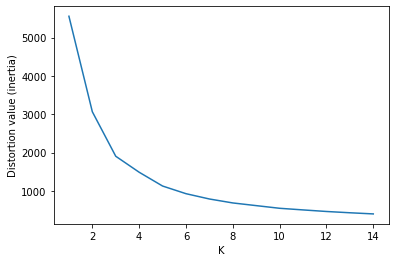

In [11]:
from matplotlib import pyplot as plt

plt.xlabel('K')
plt.ylabel('Distortion value (inertia)')
plt.plot(k_range, list_dist)
plt.show()

In [12]:
#let's build a K-Means model for K = 5
model = KMeans(n_clusters = 5)
y_predicted = model.fit_predict(df_2014[['X_scaled', 'Y_scaled']])
y_predicted

array([4, 1, 1, ..., 1, 2, 1])

In [13]:
df_2014['cluster'] = y_predicted
df_2014

C:\Users\MBK's EXCALIBUR\AppData\Local\Temp\ipykernel_1464\1025803174.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2014['cluster'] = y_predicted


,Dates,Category,X,Y,X_scaled,Y_scaled,cluster
27584,2014,LARCENY/THEFT,-122.435563,37.760801,0.526134,0.471397,4
27585,2014,LARCENY/THEFT,-122.433575,37.800037,0.539528,0.821894,1
27586,2014,VEHICLE THEFT,-122.412777,37.786834,0.679676,0.703952,1
27587,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098,4
27588,2014,ASSAULT,-122.421702,37.773641,0.619540,0.586098,4
...,...,...,...,...,...,...,...
102345,2014,OTHER OFFENSES,-122.387235,37.719401,0.851793,0.101571,2
102346,2014,WARRANTS,-122.387235,37.719401,0.851793,0.101571,2
102347,2014,FRAUD,-122.418382,37.783258,0.641908,0.672007,1
102348,2014,NON-CRIMINAL,-122.413652,37.728320,0.673778,0.181249,2


## Let's looking at the our results.

In [14]:
import plotly.express as px

In [19]:
figure = px.scatter_mapbox(df_2014, lat = 'Y', lon = 'X', center = dict(lat = 37.8, lon = -122.4), zoom = 9, 
                           opacity = .9, mapbox_style = 'stamen-terrain', color = 'cluster', 
                           title = 'San Fransisco Crime Districts', width = 1100, height = 700,
                           hover_data = ['cluster', 'Category', 'Y', 'X'])
figure.show()

In [20]:
import plotly
plotly.offline.plot(figure, filename = 'maptest.html', auto_open = True)

'maptest.html'

In [21]:
help(px.scatter_mapbox)

Help on function scatter_mapbox in module plotly.express._chart_types:

scatter_mapbox(data_frame=None, lat=None, lon=None, color=None, text=None, hover_name=None, hover_data=None, custom_data=None, size=None, animation_frame=None, animation_group=None, category_orders=None, labels=None, color_discrete_sequence=None, color_discrete_map=None, color_continuous_scale=None, range_color=None, color_continuous_midpoint=None, opacity=None, size_max=None, zoom=8, center=None, mapbox_style=None, title=None, template=None, width=None, height=None) -> plotly.graph_objs._figure.Figure
        In a Mapbox scatter plot, each row of `data_frame` is represented by a
        symbol mark on a Mapbox map.
        
    Parameters
    ----------
    data_frame: DataFrame or array-like or dict
        This argument needs to be passed for column names (and not keyword
        names) to be used. Array-like and dict are tranformed internally to a
        pandas DataFrame. Optional: if missing, a DataFrame gets